## The Museum of Modern Art (MoMA) Collection
### MoMa updates a dataet every year containing all of their artwork and the artists behind them. The collection contains almost 200,000 works from around the world spanning the last 150 years. The collection includes an ever-expanding range of visual expression, including painting, sculpture, printmaking, drawing, photography, architecture, design, film, and media and performance art. I'm not quite sure what I want to investigate in this dataset but one cool thing would be to look at how gender and race is represented at the museum over time. 

In [161]:
import pandas as pd
import numpy as np
import os
import re
import matplotlib.pyplot as plt

pd.options.mode.chained_assignment = None  # default='warn'


In [136]:
df2 = pd.read_csv(os.path.join("Artworks.csv") , names=[
        'title', 
        'artist_name', 
        'constituent_id', 
        'artist_bio', 
        'nationality', 
        'begin_date', 
        'end_date', 
        'gender', 
        'date', 
        'medium', 
        'dimensions', 
        'credit_line', 
        'accession_number', 
        'classification', 
        'department', 
        'date_acquired', 
        'cataloged', 
        'object_id', 
        'url', 
        'thumbnail_url', 
        'circumference_cm', 
        'depth_cm', 
        'diameter_cm', 
        'height_cm', 
        'length_cm', 
        'weight_kg', 
        'width_cm', 
        'seat_height_cm', 
        'durcation_seconds']).drop(0, axis=0)

df2 = df2.sample(1000)

# get rows of artists from artwork_df
#df2 = df2[['constituent_id', 'artist_name', 'nationality', 'gender']].drop_duplicates()

# replace empty strings with NaNs
df2 = df2.replace('', np.nan, regex=True)

# show data
display(df2.head())
print(df2.shape)

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (17,20,21,22,23,24,25,26,27,28) have mixed types.Specify dtype option on import or set low_memory=False.


,title,artist_name,constituent_id,artist_bio,nationality,begin_date,end_date,gender,date,medium,...,thumbnail_url,circumference_cm,depth_cm,diameter_cm,height_cm,length_cm,weight_kg,width_cm,seat_height_cm,durcation_seconds
16186,In-text plate (page 41) from A TRAVEL BOOK,Fred Martin,3791,"(American, born 1927)",(American),(1927),(0),(Male),1976,NaN,...,NaN,NaN,NaN,NaN,21.0,NaN,NaN,23.0,NaN,NaN
97005,Excreta Fluxorum,George Maciunas,21398,"(American, born Lithuania. 1931–1978)",(American),(1931),(1978),(Male),1978,"Plastic box with offset label, containing objects in various media with offset labels",...,http://www.moma.org/media/W1siZiIsIjI0NjU1NiJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=71b62fbc24ee916b,NaN,5.8,NaN,22.5,NaN,NaN,33.0,NaN,NaN
1376,Badagara Cloth,Sheila Hicks,2631,"(American, born 1934)",(American),(1934),(0),(Female),1965,Cotton,...,http://www.moma.org/media/W1siZiIsIjI4NjY2OCJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=7ec317e0b7966661,NaN,NaN,NaN,NaN,36.8301,NaN,43.1801,NaN,NaN
38111,"Fontaine du passage, 6 rue des Guillemites",Eugène Atget,229,"(French, 1857–1927)",(French),(1857),(1927),(Male),1911,Matte albumen silver print,...,http://www.moma.org/media/W1siZiIsIjI4Mzc0MSJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=23a3c42a39025453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
132248,The Nutty Professor storyboards,"John Jensen, Jerry Lewis","74235, 69618","(American, 1924–2003) (American, 1926–2017)",(American) (American),(1924) (1926),(2003) (2017),() (Male),NaN,NaN,...,NaN,NaN,0.0,NaN,27.940056,NaN,NaN,21.590043,NaN,NaN


(1000, 29)


In [138]:
#which artist is the most repoersented? 

artists = df2.groupby("artist_name").count()
artists.sort_values(by=['constituent_id'], ascending=False)
 


,title,constituent_id,artist_bio,nationality,begin_date,end_date,gender,date,medium,dimensions,...,thumbnail_url,circumference_cm,depth_cm,diameter_cm,height_cm,length_cm,weight_kg,width_cm,seat_height_cm,durcation_seconds
artist_name,,,,,,,,,,,,,,,,,,,,,
Eugène Atget,44,44,44,44,44,44,44,44,44,30,...,25,0,0,0,4,0,0,4,0,0
Louise Bourgeois,27,27,27,27,27,27,27,27,27,27,...,24,0,2,0,26,0,0,26,0,0
Ludwig Mies van der Rohe,23,23,23,23,23,23,23,23,23,23,...,10,0,1,0,23,0,0,23,0,0
Unknown photographer,21,21,0,21,21,21,21,21,21,21,...,15,0,0,1,16,0,0,16,0,0
Jean Dubuffet,10,10,10,10,10,10,10,10,9,8,...,5,0,0,0,8,0,0,8,0,0
Unknown Artist,8,8,8,8,8,8,8,8,7,6,...,4,0,1,0,6,1,0,6,0,0
Pablo Picasso,8,8,8,8,8,8,8,8,8,8,...,8,0,0,0,8,0,0,8,0,0
August Sander,8,8,8,8,8,8,8,8,8,8,...,7,0,0,0,2,0,0,2,0,0
Émile Bernard,7,7,7,7,7,7,7,7,7,7,...,3,0,0,0,7,0,0,7,0,0


In [139]:
#which medium is the most popular? 
medium = df2.groupby("medium").count()
medium.sort_values(by=['constituent_id'], ascending=False)


,title,artist_name,constituent_id,artist_bio,nationality,begin_date,end_date,gender,date,dimensions,...,thumbnail_url,circumference_cm,depth_cm,diameter_cm,height_cm,length_cm,weight_kg,width_cm,seat_height_cm,durcation_seconds
medium,,,,,,,,,,,,,,,,,,,,,
Gelatin silver print,131,130,130,113,130,130,130,130,131,129,...,84,0,9,0,119,0,0,119,0,0
Lithograph,44,44,44,44,44,44,44,44,43,42,...,27,0,5,0,42,0,0,42,0,0
Albumen silver print,42,42,42,42,42,42,42,42,42,29,...,19,0,0,0,8,0,0,8,0,0
Chromogenic color print,15,15,15,15,15,15,15,15,15,15,...,11,0,0,0,15,0,0,15,0,0
"Video (color, sound)",13,13,13,12,13,13,13,13,13,12,...,10,0,0,0,0,0,0,0,0,10
Pencil on paper,11,11,11,11,11,11,11,11,11,11,...,7,0,0,0,11,0,0,11,0,0
Letterpress,11,11,11,11,11,11,11,11,11,11,...,9,0,0,0,11,0,0,11,0,0
Oil on canvas,11,11,11,11,11,11,11,11,11,11,...,11,0,1,0,11,0,0,10,0,0
Etching,10,10,10,10,10,10,10,10,10,8,...,7,0,0,0,8,0,0,8,0,0


In [140]:
#clean start and end date 
df2['end_date'] = df2['end_date'].astype(str)

df2['end_date'] = df2['end_date'].str.replace('(',' ')
df2['end_date'] = df2['end_date'].str.replace(')',' ')


df2['begin_date'] = df2['begin_date'].astype(str)

df2['begin_date'] = df2['begin_date'].str.replace('(',' ')
df2['begin_date'] = df2['begin_date'].str.replace(')',' ')

df2


/var/folders/th/rs4zk3q55y3dxsm259ph3h3w0000gn/T/ipykernel_61260/3168759267.py:4: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
/var/folders/th/rs4zk3q55y3dxsm259ph3h3w0000gn/T/ipykernel_61260/3168759267.py:5: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
/var/folders/th/rs4zk3q55y3dxsm259ph3h3w0000gn/T/ipykernel_61260/3168759267.py:10: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
/var/folders/th/rs4zk3q55y3dxsm259ph3h3w0000gn/T/ipykernel_61260/3168759267.py:11: FutureWarning: The default value of regex will change from True 

,title,artist_name,constituent_id,artist_bio,nationality,begin_date,end_date,gender,date,medium,...,thumbnail_url,circumference_cm,depth_cm,diameter_cm,height_cm,length_cm,weight_kg,width_cm,seat_height_cm,durcation_seconds
16186,In-text plate (page 41) from A TRAVEL BOOK,Fred Martin,3791,"(American, born 1927)",(American),1927,0,(Male),1976,NaN,...,NaN,NaN,NaN,NaN,21.0,NaN,NaN,23.0,NaN,NaN
97005,Excreta Fluxorum,George Maciunas,21398,"(American, born Lithuania. 1931–1978)",(American),1931,1978,(Male),1978,"Plastic box with offset label, containing objects in various media with offset labels",...,http://www.moma.org/media/W1siZiIsIjI0NjU1NiJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=71b62fbc24ee916b,NaN,5.8,NaN,22.5,NaN,NaN,33.0,NaN,NaN
1376,Badagara Cloth,Sheila Hicks,2631,"(American, born 1934)",(American),1934,0,(Female),1965,Cotton,...,http://www.moma.org/media/W1siZiIsIjI4NjY2OCJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=7ec317e0b7966661,NaN,NaN,NaN,NaN,36.8301,NaN,43.1801,NaN,NaN
38111,"Fontaine du passage, 6 rue des Guillemites",Eugène Atget,229,"(French, 1857–1927)",(French),1857,1927,(Male),1911,Matte albumen silver print,...,http://www.moma.org/media/W1siZiIsIjI4Mzc0MSJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=23a3c42a39025453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
132248,The Nutty Professor storyboards,"John Jensen, Jerry Lewis","74235, 69618","(American, 1924–2003) (American, 1926–2017)",(American) (American),1924 1926,2003 2017,() (Male),NaN,NaN,...,NaN,NaN,0.0,NaN,27.940056,NaN,NaN,21.590043,NaN,NaN
41491,"House, Somerville, Massachusetts",Walker Evans,1777,"(American, 1903–1975)",(American),1903,1975,(Male),1932,Gelatin silver print,...,http://www.moma.org/media/W1siZiIsIjI1OTQxNiJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=5371425120fd9211,NaN,NaN,NaN,10.5,NaN,NaN,15.9,NaN,NaN
78637,Study for George Washington Crossing the Delaware,Larry Rivers,4945,"(American, 1923–2002)",(American),1923,2002,(Male),(1953),Pencil on paper,...,http://www.moma.org/media/W1siZiIsIjIxNTgyMCJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=904a9bff8d21ef06,NaN,NaN,NaN,35.2426,NaN,NaN,41.9101,NaN,NaN
32252,Seventeen untitled drawings,Raymond Pettibon,7500,"(American, born 1957)",(American),1957,0,(Male),1987-1995,Pen and ink on paper,...,NaN,NaN,0.0,NaN,0.0,NaN,NaN,0.0,NaN,NaN
132520,Iced Dice (Haircut) from Fluxus 1,George Brecht,756,"(American, 1926–2008)",(American),1926,2008,(Male),"1964, assembled c. 1965-66",Offset card,...,NaN,NaN,6.0,NaN,19.2,NaN,NaN,21.5,NaN,NaN
123262,Cash from Chaos/Unicorns and Rainbows,"Alex Bag, Patterson Beckwith","47579, 47578","(American, born 1969) (American, born 1972)",(American) (American),1969 1972,0 0,(Female) (Male),1994-97,"Multi-channel video (color, sound)",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<AxesSubplot:xlabel='begin_date', ylabel='end_date'>

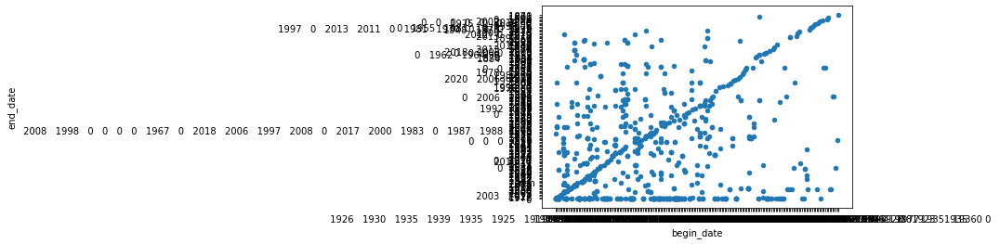

In [141]:
#see when art pieces get on displaied relative to when they were bought 
df2.plot.scatter(x = 'begin_date', y = 'end_date')

In [146]:
df1 = pd.read_csv(os.path.join("Artworks.csv") , names=[
        'title', 
        'artist_name', 
        'constituent_id', 
        'artist_bio', 
        'nationality', 
        'begin_date', 
        'end_date', 
        'gender', 
        'date', 
        'medium', 
        'dimensions', 
        'credit_line', 
        'accession_number', 
        'classification', 
        'department', 
        'date_acquired', 
        'cataloged', 
        'object_id', 
        'url', 
        'thumbnail_url', 
        'circumference_cm', 
        'depth_cm', 
        'diameter_cm', 
        'height_cm', 
        'length_cm', 
        'weight_kg', 
        'width_cm', 
        'seat_height_cm', 
        'durcation_seconds']).drop(0, axis=0)

df1 = df1.sample(1000)

df1

,title,artist_name,constituent_id,artist_bio,nationality,begin_date,end_date,gender,date,medium,...,thumbnail_url,circumference_cm,depth_cm,diameter_cm,height_cm,length_cm,weight_kg,width_cm,seat_height_cm,durcation_seconds
117073,Parallel Fears,"Lee Jaffe, Harry Shunk, János Kender","44912, 8247, 38024","(American, born 1950) (German, 1924–2006) (Hungarian, 1937–2009)",(American) (French) (Hungarian),(1950) (1924) (1937),(0) (2006) (2009),(Male) (Male) (Male),1971,Gelatin silver print,...,http://www.moma.org/media/W1siZiIsIjI5MDM4MyJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=d1f3550ac11ef5a0,NaN,0.0,NaN,17.780036,NaN,NaN,25.400051,NaN,NaN
74220,Phases of the Moon,Paul Delvaux,1485,"(Belgian, 1897–1994)",(Belgian),(1897),(1994),(Male),March 1939,Oil on canvas,...,http://www.moma.org/media/W1siZiIsIjE1MDg5NyJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=5238c024edb36002,NaN,NaN,NaN,139.7,NaN,NaN,160.0,NaN,NaN
110759,C-A-N-V-A-S Painting 10,Michael Krebber,19163,"(German, born 1954)",(German),(1954),(0),(Male),2011,Synthetic polymer paint on canvas,...,http://www.moma.org/media/W1siZiIsIjI0NDUzOSJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=de3b6a6b38ad6161,NaN,0.0,NaN,139.700279,NaN,NaN,106.680213,NaN,NaN
52123,"Tampa, Florida",Lewis W. Hine,2657,"(American, 1874–1940)",(American),(1874),(1940),(Male),1909,Gelatin silver print,...,http://www.moma.org/media/W1siZiIsIjIwMDUyOSJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=5f776ab2de098245,NaN,NaN,NaN,11.5,NaN,NaN,16.2,NaN,NaN
41145,Cyprès,Eugène Atget,229,"(French, 1857–1927)",(French),(1857),(1927),(Male),1923-25,Matte albumen silver print,...,http://www.moma.org/media/W1siZiIsIjMxOTUxNCJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=fd0db63856831aad,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
29879,"The Stag (Le Cerf) (plate, folio 37) from Histoires Naturelles",Henri de Toulouse-Lautrec,5910,"(French, 1864–1901)",(French),(1864),(1901),(Male),"1897, published 1899",One from an illustrated book with 23 transfer lithographs (including wrapper front),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
48614,"Knoxville, Tennessee",William Gedney,2105,"(American, 1932–1989)",(American),(1932),(1989),(Male),August 1972,"Gelatin silver print, printed September 1972",...,http://www.moma.org/media/W1siZiIsIjE4NjczNSJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=10ff944c141e41b0,NaN,NaN,NaN,19.5,NaN,NaN,28.6,NaN,NaN
44294,"Carpatho-Ukraine, Village of Bolidan-Lush",Margaret Bourke-White,712,"(American, 1904–1971)",(American),(1904),(1971),(Female),c. 1938,Gelatin silver print,...,http://www.moma.org/media/W1siZiIsIjE5Nzc0MCJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=dedc97113c9a59b6,NaN,NaN,NaN,25.4,NaN,NaN,33.7,NaN,NaN
92155,15 Big Shots,Garry Winogrand,6399,"(American, 1928–1984)",(American),(1928),(1984),(Male),1955-1981,"Gelatin silver prints, printed 1983",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
55215,Northern California Coast Redwoods,Ansel Adams,60,"(American, 1902–1984)",(American),(1902),(1984),(Male),1960,"Gelatin silver print, printed 1963",...,NaN,NaN,NaN,NaN,24.0,NaN,NaN,29.2,NaN,NaN


In [151]:
df1['gender'] = df1['gender'].str.replace('(',' ')
df1['gender'] = df1['gender'] .str.replace(')',' ')
df1

/var/folders/th/rs4zk3q55y3dxsm259ph3h3w0000gn/T/ipykernel_61260/3417663486.py:1: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
/var/folders/th/rs4zk3q55y3dxsm259ph3h3w0000gn/T/ipykernel_61260/3417663486.py:2: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.


,title,artist_name,constituent_id,artist_bio,nationality,begin_date,end_date,gender,date,medium,...,thumbnail_url,circumference_cm,depth_cm,diameter_cm,height_cm,length_cm,weight_kg,width_cm,seat_height_cm,durcation_seconds
117073,Parallel Fears,"Lee Jaffe, Harry Shunk, János Kender","44912, 8247, 38024","(American, born 1950) (German, 1924–2006) (Hungarian, 1937–2009)",(American) (French) (Hungarian),(1950) (1924) (1937),(0) (2006) (2009),Male Male Male,1971,Gelatin silver print,...,http://www.moma.org/media/W1siZiIsIjI5MDM4MyJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=d1f3550ac11ef5a0,NaN,0.0,NaN,17.780036,NaN,NaN,25.400051,NaN,NaN
74220,Phases of the Moon,Paul Delvaux,1485,"(Belgian, 1897–1994)",(Belgian),(1897),(1994),Male,March 1939,Oil on canvas,...,http://www.moma.org/media/W1siZiIsIjE1MDg5NyJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=5238c024edb36002,NaN,NaN,NaN,139.7,NaN,NaN,160.0,NaN,NaN
110759,C-A-N-V-A-S Painting 10,Michael Krebber,19163,"(German, born 1954)",(German),(1954),(0),Male,2011,Synthetic polymer paint on canvas,...,http://www.moma.org/media/W1siZiIsIjI0NDUzOSJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=de3b6a6b38ad6161,NaN,0.0,NaN,139.700279,NaN,NaN,106.680213,NaN,NaN
52123,"Tampa, Florida",Lewis W. Hine,2657,"(American, 1874–1940)",(American),(1874),(1940),Male,1909,Gelatin silver print,...,http://www.moma.org/media/W1siZiIsIjIwMDUyOSJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=5f776ab2de098245,NaN,NaN,NaN,11.5,NaN,NaN,16.2,NaN,NaN
41145,Cyprès,Eugène Atget,229,"(French, 1857–1927)",(French),(1857),(1927),Male,1923-25,Matte albumen silver print,...,http://www.moma.org/media/W1siZiIsIjMxOTUxNCJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=fd0db63856831aad,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
29879,"The Stag (Le Cerf) (plate, folio 37) from Histoires Naturelles",Henri de Toulouse-Lautrec,5910,"(French, 1864–1901)",(French),(1864),(1901),Male,"1897, published 1899",One from an illustrated book with 23 transfer lithographs (including wrapper front),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
48614,"Knoxville, Tennessee",William Gedney,2105,"(American, 1932–1989)",(American),(1932),(1989),Male,August 1972,"Gelatin silver print, printed September 1972",...,http://www.moma.org/media/W1siZiIsIjE4NjczNSJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=10ff944c141e41b0,NaN,NaN,NaN,19.5,NaN,NaN,28.6,NaN,NaN
44294,"Carpatho-Ukraine, Village of Bolidan-Lush",Margaret Bourke-White,712,"(American, 1904–1971)",(American),(1904),(1971),Female,c. 1938,Gelatin silver print,...,http://www.moma.org/media/W1siZiIsIjE5Nzc0MCJdLFsicCIsImNvbnZlcnQiLCItcmVzaXplIDMwMHgzMDBcdTAwM2UiXV0.jpg?sha=dedc97113c9a59b6,NaN,NaN,NaN,25.4,NaN,NaN,33.7,NaN,NaN
92155,15 Big Shots,Garry Winogrand,6399,"(American, 1928–1984)",(American),(1928),(1984),Male,1955-1981,"Gelatin silver prints, printed 1983",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
55215,Northern California Coast Redwoods,Ansel Adams,60,"(American, 1902–1984)",(American),(1902),(1984),Male,1960,"Gelatin silver print, printed 1963",...,NaN,NaN,NaN,NaN,24.0,NaN,NaN,29.2,NaN,NaN


In [147]:
# Toggle this value to show or hide NaN values
PLOT_NAN_VALUES = True

In [157]:
#male vs female artist 
dist_df=df1['gender'].value_counts(dropna=True)
dist_df

 Male                                                                                                                                                                                                  738
 Female                                                                                                                                                                                                134
                                                                                                                                                                                                        61
 Male   Male                                                                                                                                                                                            14
 Male   Male   Male                                                                                                                                                                         

In [160]:
#nationality of artist 
nas_df=df1['nationality'].value_counts(dropna=True)
nas_df

(American)                                                                                                                                                                                                                                                                                      408
(French)                                                                                                                                                                                                                                                                                        163
(German)                                                                                                                                                                                                                                                                                         71
(British)                                                                                                                   